# Visualizing topics in Indian Parliamentary Discussions
##### Salil Harsulkar | Indiana University | samihars@iu.edu
##### Visualization Project for MS in Data Science, Course I590-8433

## Project abstract:
India is the largest democracy in the world and has a bicameral legislature consisting of an upper house called ‘Rajya Sabha’ which represent the states of the Indian federation and the lower house called ‘Lok Sabha’ which represent the people of India as whole. [1] These two houses are the heart of Indian legislature and all decisions pertaining to the present and future of India are made here. During its regular working sessions, each house discusses and debates on a variety of topics – some trivial while some are of critical national importance. At the start of each session, there is a questions hour where members can ask questions to cabinet ministers on topics related to national interest. Analyzing these questions and their answers can help extract key themes that shaped the country over the past few years. 


## Project Aim:
The main aim of this project is to perform exploratory data visualization on the vast archives of parliamentary publications publicly available on the Rajya Sabha website with the intent to uncover interesting insights about the composition, transformation and functioning of the Upper House. This project also aims at performing topical analysis of questions asked on the floor of the House and highlight any trends in discussion topics by State and by Ministry over the past decade.


## Motivation:
A democratic country like India can only be successful if its people actively participate in the politics and decision-making process for their country. For the majority population, the news media is the primary source of political information. Though news media is effective in its reach, it is not free from bias. 
Rajya Sabha publishes records of its debates, discussions and questions on its website. There is currently no platform available in India that can source data from the parliamentary publications, transform it and present it to the people in a way that is easy to comprehend. 
The other constraint is that of language. India is a multi-lingual country with 22 official languages and close to 150 languages that have a sizable population. The legislative verbiage is mainly published in English and Hindi and is too complicated for a layman to understand. Crisp visualizations will help in making the archives more accessible to the general public.
With the power of machine learning, natural language processing and effective data visualization, this project will attempt to provide a solution to these problems.


## Analysis of existing visualizations:
I will be referencing the work done by my fellow students for the visualizations [4] created for IVMOOC course as part of MS in Data Science program of Indiana University, Bloomington in spring 2018. They had similar objective of visualizing government meetings data from the city council for Bloomington, Indiana. Their project report has some good visualizations that I plan to replicate in this project – for instance the use of Sankey graph to plot the flow of applications through the legislative process can be reused. They have also used network visualization to plot interdependencies between words used in the applications. It may be applicable for this project as well.

On the downside, the dataset that was used for their project is considerably smaller and has less variance in features than what this project has.


In [2]:
#Lets import required libraries and methods
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib as mlt
import matplotlib.pyplot as plt
import matplotlib.style as style 
import matplotlib.cm as cm #colormap

from datetime import datetime, timedelta, date
from dateutil import relativedelta

import warnings
warnings.filterwarnings('ignore')
%matplotlib inline

## Visualizations and Insights:
### Visualizing the current (2018) composition of Rajya Sabha:
#### Description: 
Rajya Sabha, also called the Council of States, has 245 seats for representatives of the States and Union Territories of Republic of India. This custom designed visualization shows the composition of the 2018 Rajya Sabha and the distribution of seats along the dimensions of gender, special responsibilities and political affiliations. Each point in the plot represents a seat.
#### Why this visualization type:
Bar chart and donut chart were considered before finalizing on this visualization type. Both bar and donut charts looked cluttered and mundane and were unable to present the idea effectively. This custom scatter plot was designed to mimic the arrangement of a circular assembly with each point in the plot representing a member. Color encoding was used to highlight different topics. The size and position of the points was maintained so that all five plots can be animated as a GIF.

In [11]:
##Code to create the assembly seats visualization - 5 concentric eclipses that accomodate 250 points
x=[]
y=[]
#Generate polar coordinates to plot the circles
radius=[10,12,14,16,18]
theta=np.linspace(0,360,50)
#Generate polar coordinates
for i in radius:
    x.append(i*np.cos(theta))
    y.append(i*np.sin(theta))
#Transpose array
x_t=np.transpose(x)
y_t=np.transpose(y)
#reshape to 1-D array to plot
x=np.reshape(x_t,len(x)*len(x[1]))
y=np.reshape(y_t,len(y)*len(y[1]))
#reindexing helps us to plot similar points together
reindex=np.reshape([[np.linspace(5*i+1,5*i+5,5)] for i in np.append(np.reshape(np.transpose(np.reshape(range(48),(8,6))),48),[48,49])],250).astype(int)
#generate (X,Y) from reindexed array
x=x[reindex-1]
y=y[reindex-1]

In [4]:
#use dark background for visualization
style.use('dark_background')

In [7]:
#load the 2018 member details file into Pandas Dataframe
df_members=pd.read_excel('C:/Users/hsalil89/Documents/DS/Data Visualization/project/Data/rajyasabha_member_details_2018.xlsx')

#### Data Collection: 
The data for this visualization has been scraped from the Rajya Sabha website from the section 'Sitting members'. http://164.100.47.5/Newmembers/memberlist.aspx. The data looks as below -

In [8]:
##view data
df_members.head(5)

,Sno,Name,Party,State,FemaleY_N,MinisterY_N
0,1,"Chowdary, Shri Y. S.",TDP,Andhra Pradesh,N,N
1,2,"Kanakamedala Ravindra Kumar, Shri",TDP,Andhra Pradesh,N,N
2,3,"Khan, Shri Mohd. Ali",INC,Andhra Pradesh,N,N
3,4,"Prabhu, Shri Suresh",BJP,Andhra Pradesh,N,Y
4,5,"Ramesh, Shri C.M.",TDP,Andhra Pradesh,N,N


Text(0.5,1,'Total seats in Rajya Sabha = 245')

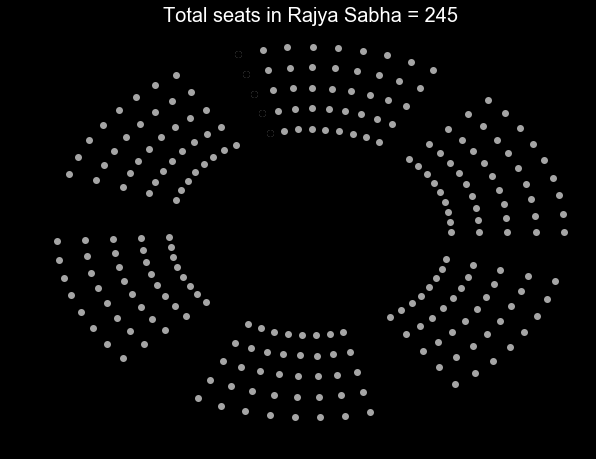

In [23]:
#Plot the total seats in Rajya Sabha first
fig, axes = plt.subplots(figsize=(10,7.5))
plt.plot(x, y, 'o', color='w',alpha=0.65)
plt.plot(x[245:250], y[245:250], 'o', color='black')
plt.axis('off')
plt.title('Total seats in Rajya Sabha = 245',fontsize=20)

Text(0.5,1,'Currently there are 9 vacant seats in Rajya Sabha.')

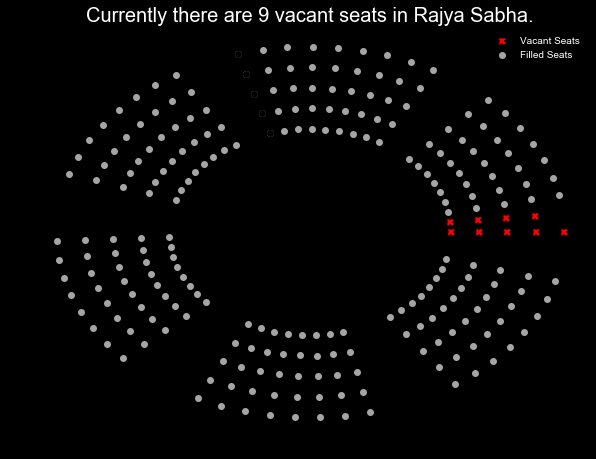

In [21]:
#PLot the number of vacant seats
fig, axes = plt.subplots(figsize=(10,7.5))
counter=0
idx=0
count_by_party=df_members.groupby('Party').size()
count_by_party.sort_values(ascending=True,inplace=True)
vacant=pd.Series([count_by_party['No Party']],index=(['No Party']))

vacant['Filled Seats']=sum(count_by_party[key] for key in count_by_party.keys() if key not in ['No Party'])
vacant.sort_values(ascending=True,inplace=True)
key_vacant=vacant.keys()
c=['r','w']
symbol=['X','o']
alpha=[1,0.65]
labels=['Vacant Seats','Filled Seats']

for i in vacant.values+1:
    #print(i,counter,counter+i-1)
    plt.plot(x[counter:counter+i-1], y[counter:counter+i-1], symbol[idx], color=c[idx],label=labels[idx],alpha=alpha[idx])
    counter=counter+i
    idx=idx+1

#As 250 points are plotted, hide 5 points
plt.plot(x[245:250], y[245:250], 'o', color='black') 
plt.legend(loc='best')
plt.axis('off')
plt.title('Currently there are '+ str(vacant[0]) +' vacant seats in Rajya Sabha.',fontsize=20)

Text(0.5,1,'Currently 20 members in Rajya Sabha serve as Cabinet Ministers')

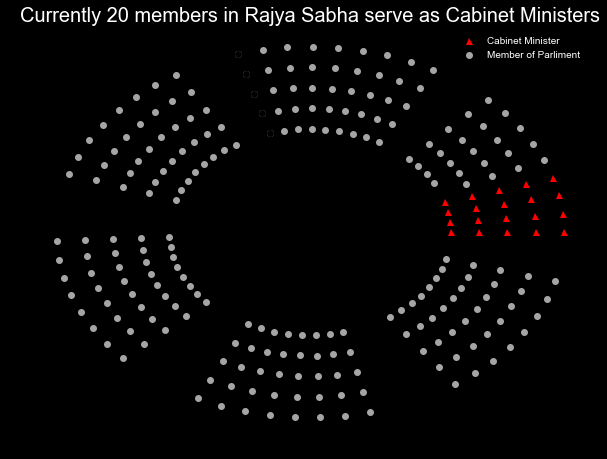

In [24]:
#Plot the count of ministers
fig, axes = plt.subplots(figsize=(10,7.5))
counter=0
idx=0
count_of_ministers=df_members.groupby('MinisterY_N').size()
count_of_ministers.sort_values(ascending=True,inplace=True)
key_by_ministers=count_of_ministers.keys()
c=['r','w']
labels=['Cabinet Minister','Member of Parliment']
symbol=['^','o']
alpha=[1.0,0.65]

for i in count_of_ministers.values+1:
    #print(i,counter,counter+i-1)
    plt.plot(x[counter:counter+i-1], y[counter:counter+i-1], symbol[idx], color=c[idx],label=labels[idx],alpha=alpha[idx])
    counter=counter+i
    idx=idx+1
#As 250 points are plotted, hide 5 points
plt.plot(x[245:250], y[245:250], 'o', color='black') 

plt.legend(loc='best')
plt.axis('off')
plt.title('Currently '+ str(count_of_ministers[0]) +' members in Rajya Sabha serve as Cabinet Ministers',fontsize=20)

Text(0.5,1,'Currently there are 27 women members in Rajya Sabha')

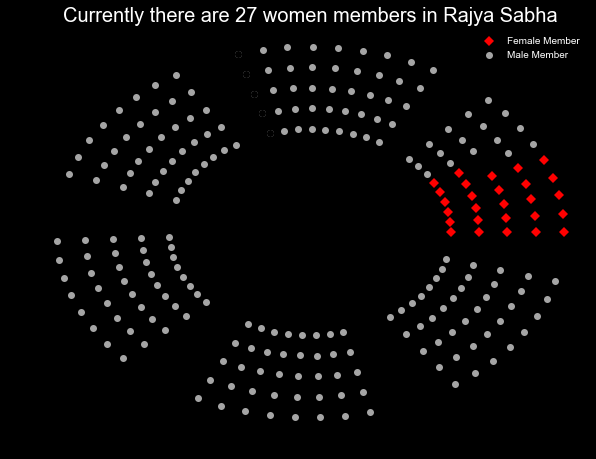

In [25]:
#Plot count of women members
fig, axes = plt.subplots(figsize=(10,7.5))
counter=0
idx=0
count_of_women=df_members.groupby('FemaleY_N').size()
count_of_women.sort_values(ascending=True,inplace=True)
key_by_women=count_of_women.keys()
labels=['Female Member','Male Member']
c=['r','w']
symbol=['D','o']
alpha=[1.0,0.65]

for i in count_of_women.values+1:
    #print(i,x[counter:counter+i-1], y[counter:counter+i-1])
    plt.plot(x[counter:counter+i-1], y[counter:counter+i-1], symbol[idx], color=c[idx],label=labels[idx],alpha=alpha[idx])
    counter=counter+i
    idx=idx+1
#As 250 points are plotted, hide 5 points
plt.plot(x[245:250], y[245:250], 'o', color='black') 

plt.legend(loc='best')
plt.axis('off')
plt.title('Currently there are '+ str(count_of_women[0]) +' women members in Rajya Sabha',fontsize=20)

Text(0.5,1,'Member distribution according to party affiliations')

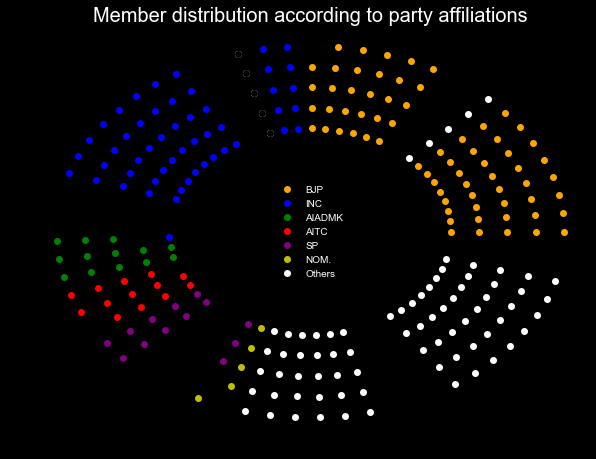

In [26]:
#Plot count by party
fig, axes = plt.subplots(figsize=(10,7.5))
counter=0
idx=0
count_by_party=df_members.groupby('Party').size()
count_by_party.sort_values(ascending=True,inplace=True)
party_reduced=pd.Series([count_by_party['BJP'],count_by_party['INC'],count_by_party['AIADMK'],count_by_party['AITC'],
                         count_by_party['SP'],count_by_party['NOM.']],index=('BJP','INC','AIADMK','AITC','SP','NOM.'))

party_reduced['Others']=sum(count_by_party[key] for key in count_by_party.keys() if key not in ['BJP','INC','AIDMK','AITC','SP','NOM.'])
key_by_party=party_reduced.keys()
c=['orange','b','g','r','purple','y','white']

for i in party_reduced.values+1:
    #print(i,counter,counter+i-1)
    plt.plot(x[counter:counter+i-1], y[counter:counter+i-1], 'o', color=c[idx],label=key_by_party[idx])
    counter=counter+i
    idx=idx+1
#As 250 points are plotted, hide 5 points
plt.plot(x[245:250], y[245:250], 'o', color='black') 

plt.legend(loc='best')
plt.axis('off')
plt.title('Member distribution according to party affiliations',fontsize=20)

### Visualizing number of seats by State:
#### Description: 
The Indian Constitution has allotted fixed number of seats per state and union territory in proportion to the population residing in the state. Only the Union Territories of Pondicherry and NCR Delhi are allocated membership, while the other five are not (visualized by red ‘X’ in the map).
#### Why this visualization type:
Proportional symbol map was chosen for this 
Visualization because it accurately encodes the
number of seats in relation to the physical location 
of the state. In addition to showing location and 
magnitude, the visualization is also able to clearly show which Union Territories do not have representation. Even though the map only outlines India’s international border, most of the audience can recognize states by their location.
#### Data Collection: 
The data for this visualization has been collected from 2011 census from the website https://www.census2011.co.in/states.php.

In [27]:
#Import cartopy to plot maps
import cartopy.crs as ccrs
import cartopy.feature as cfeature


In [28]:
#Load the 2011 Census file into a dataframe
StateCensus=pd.read_csv('C:\\Users\\hsalil89\\Documents\\DS\\Data Visualization\\project\\Data\\India_2011census_state.csv')

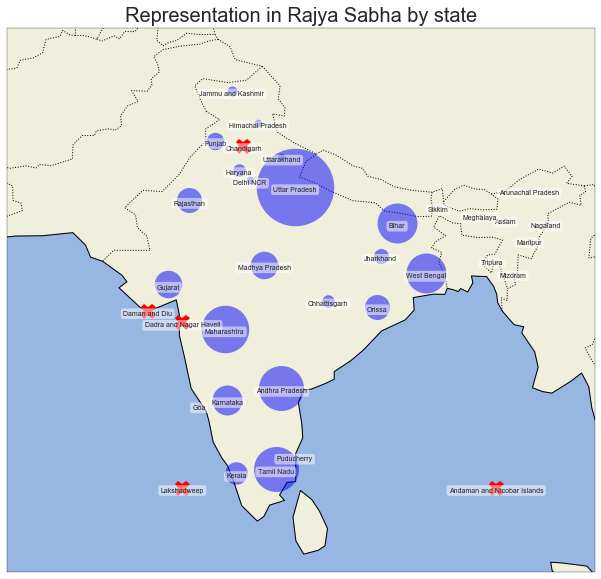

In [31]:
#Plot the distribution of representatives by state
style.use('seaborn-white')
fig = plt.figure(figsize=(15,10))
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree())
ax.set_extent([62.4, 97.96,4.9, 37.8], crs=ccrs.PlateCarree())
ax.add_feature(cfeature.LAND)
ax.add_feature(cfeature.OCEAN)
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.BORDERS, linestyle=':')
#ax.add_feature(cfeature.STATES, linestyle=':')

for i in range(StateCensus.shape[0]):
    lat,lon,density,rep,state = StateCensus[['Latitude','Longitude','Density','Rajyasabha representation','State']].iloc[i]
    
    if rep>0:
        ax.plot(lon, lat, marker='o', color='blue', markersize=rep*2.5, alpha=0.5)
    else:
        ax.plot(lon, lat, marker='X', color='red',markersize=15)
    ax.text(lon, lat, state,verticalalignment='top', horizontalalignment='center',fontsize=7,
            bbox=dict(facecolor='white', alpha=0.5, boxstyle='round'))
plt.title('Representation in Rajya Sabha by state',fontsize=20)    
plt.show()

### Visualizing India’s Geographical Evolution (1952-2018):
#### Description: 
This visualization encoded to look like the Indian National Flag plots the representation of States and Union Territories in Rajya Sabha on the timeline from 1952 – 2018. The states encoded in orange color have a continuous representation across the entire timescale. The states in gray color no longer exist while the ones in green color were formed after 1952. The circular bar chart in the center shows the count of states represented in a 3-year time slots between 1952 – 2016.
#### Why this visualization type:
The Gantt chart is the most suitable chart to plot time series. This visualization plots the timelines of representation of states in Rajya Sabha with start and end years. This chart also enabled me to customize it according to the underlying context of India. 
#### Data Collection: 
The data for this visualization has been scraped from the Rajya Sabha website from the section Members->Former members located at http://164.100.47.5/Newmembers/mpterms.aspx.

In [32]:
#Load the member details for all years
members_allyears=pd.read_csv('C:/Users/hsalil89/Documents/DS/Data Visualization/project/Data/rajyasabha_member_details_allyears.csv',engine='python')

In [33]:
#States on timescale
state_timescale=members_allyears[['STATE','TERM_From','TERM_To']]
state_timescale['TERM_From']=pd.to_datetime(state_timescale['TERM_From'], format='%d/%m/%Y')
state_timescale['TERM_To']=pd.to_datetime(state_timescale['TERM_To'], format='%d/%m/%Y')

In [34]:
#Find the minimum and maximum years of representation per state
state_gantt_df=state_timescale.groupby('STATE').min()['TERM_From'].reset_index()
state_gantt_df['TERM_To']=state_timescale.groupby('STATE').max()['TERM_To'].reset_index()['TERM_To']

In [36]:
#Color code the gantt chart bars
diff=[]
color_encode=[]
for i in range(state_gantt_df.shape[0]):
    start_date,end_date = state_gantt_df[['TERM_From','TERM_To']].iloc[i]
    diff.append((end_date - start_date).days)
    if start_date.year==1952 and end_date.year>=2018:
        color_encode.append('orange')
    elif start_date.year==1952 and end_date.year<2018:
        color_encode.append('lightgrey')
    else: color_encode.append('green')
    
state_gantt_df['TERM_Diff']=diff
state_gantt_df['Color_encode']=color_encode
state_gantt_df.sort_values(by=['Color_encode','STATE'],ascending=True,inplace=True)

In [37]:
#import mpatches to plot legend
import matplotlib.patches as mpatches

Text(0.5,1,'Duration for representation of Indian States in Rajya Sabha(1952-2018)')

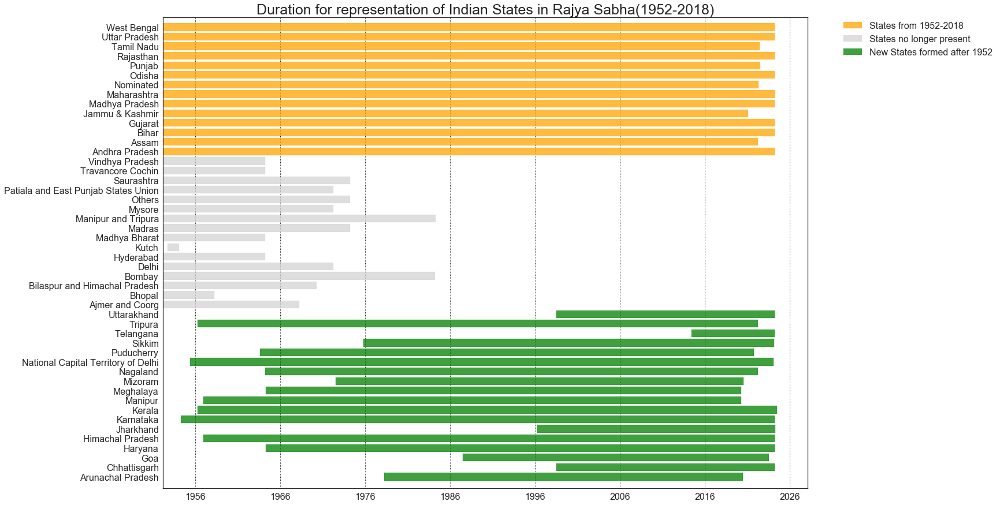

In [38]:
#Plot Gantt chart for duration of representation of states in Rajya Sabha
#Reference - http://www.clowersresearch.com/main/gantt-charts-in-matplotlib/
fig = plt.figure(figsize=(20,15))
ax = fig.add_subplot(111)
ylabels=state_gantt_df.STATE
ilen=len(ylabels)
pos = np.arange(0.5,ilen*0.5+0.5,0.5)
for i in range(len(ylabels)):
    start_date,end_date = state_gantt_df[['TERM_From','TERM_To']].iloc[i]
    ax.barh((i*0.5)+0.5, state_gantt_df.TERM_Diff.iloc[i], left=start_date, height=0.4, align='center', edgecolor=state_gantt_df.Color_encode.iloc[i], 
            color=state_gantt_df.Color_encode.iloc[i], alpha = 0.75)
locsy, labelsy = plt.yticks(pos,ylabels)
plt.setp(labelsy, fontsize = 16)
ax.axis('tight')
ax.set_ylim(ymin = -0.1, ymax = ilen*0.5+0.5)
ax.grid(axis='x',color = 'black', linestyle = ':')
plt.xticks(fontsize=16)
ax.xaxis_date()
or_patch = mpatches.Patch(color='orange',alpha = 0.75, label='States from 1952-2018')
grey_patch = mpatches.Patch(color='lightgrey',alpha = 0.75, label='States no longer present')
gr_patch = mpatches.Patch(color='green',alpha = 0.75, label='New States formed after 1952')
plt.legend(handles=[or_patch,grey_patch,gr_patch],bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.,fontsize=16)
plt.title('Duration for representation of Indian States in Rajya Sabha(1952-2018)',fontsize=25)

In [40]:
#Aggregate state counts in 3 year timeslots
gantt_year=np.linspace(1953,2019,24).astype(int)
gantt_angle=np.linspace(0,360,24).astype(int)
gantt_state_cnt=[]
for i in range(len(gantt_year)-1):
    start_date=date(gantt_year[i], 1, 1)
    end_date=date(gantt_year[i+1]-1, 12, 31)
    query_str=str('TERM_From<=\''+str(start_date)+'\' & TERM_To>=\''+str(end_date)+'\'')
    gantt_state_cnt.append(state_gantt_df.query(query_str).shape[0])

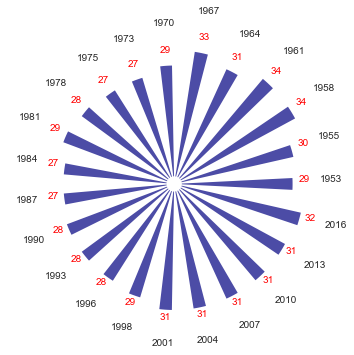

In [41]:
#Plot circular bar graph
#Reference: https://stackoverflow.com/questions/46874689/getting-labels-on-top-of-bar-in-polar-radial-bar-chart-in-matplotlib-python3
iN = len(gantt_state_cnt)
theta=np.arange(0,2*np.pi,2*np.pi/iN)
#width = (2*np.pi)/iN *0.9

fig = plt.figure(figsize=(8, 8))
ax = fig.add_axes([0.1, 0.1, 0.5, 0.5], polar=True)
bars = ax.bar(theta, gantt_state_cnt, width=0.1, bottom=2,color='navy',alpha=0.7)
ax.set_xticks(theta)
plt.axis('off')
bottom = 8
rotations = np.rad2deg(theta)
for x, bar, rotation, label, state_count  in zip(theta, bars, rotations, gantt_year,gantt_state_cnt):
    lab = ax.text(x,bottom+4+bar.get_height() , label , ha='center', va='bottom', )  
    lab = ax.text(x,bottom-3+bar.get_height() , state_count , ha='center', va='bottom',color='red' ) 

#### Insights: 
1. When India became independent in 1947, it was divided into 500+ princely states and provinces. Rajya Sabha started operating from 1952 and has representation from 29 states and provinces. The States Reorganization Act of 1956 helped restructure and consolidate the states boundaries giving rise to new states and union territories. Post 1970, the states that exist today started to form slowly. The newest state of Telangana was formed in 2014.

2. The circular bar chart shows a concise picture of the geographical evolution – the period of 1952 – 1970 sees a general increase in the number of represented states from 29 in 1953 to 34 in 1958 which then decreases to 26 in 1969. 1970 onwards, the number of states has increased steadily from 27 in 1975 to 31 in 2013.


### Visualizing Evolution of Political Parties (1952-2018):
#### Description: 
This visualization plots the political parties represented in Rajya Sabha from 1952 to 2018.

In [48]:
#Political parties on timescale
PP_timescale=members_allyears[['PARTY','TERM_From','TERM_To']]
PP_timescale['TERM_From']=pd.to_datetime(PP_timescale['TERM_From'], format='%d/%m/%Y')
PP_timescale['TERM_To']=pd.to_datetime(PP_timescale['TERM_To'], format='%d/%m/%Y')
PP_gantt_df=PP_timescale.groupby('PARTY').min()['TERM_From'].reset_index()
PP_gantt_df['TERM_To']=PP_timescale.groupby('PARTY').max()['TERM_To'].reset_index()['TERM_To']

In [49]:
#Create Gantt chart
diff=[]
color_encode=[]
for i in range(PP_gantt_df.shape[0]):
    start_date,end_date = PP_gantt_df[['TERM_From','TERM_To']].iloc[i]
    diff.append((end_date - start_date).days)
    if end_date.year>=2018:
        color_encode.append('green')
    else: color_encode.append('orange')
PP_gantt_df['TERM_Diff']=diff
PP_gantt_df['Color_encode']=color_encode
PP_gantt_df.sort_values(by=['TERM_From','Color_encode'],ascending=False,inplace=True)

Text(0.5,1,'Duration for representation of Political Parties in Rajya Sabha(1952 - 2018)')

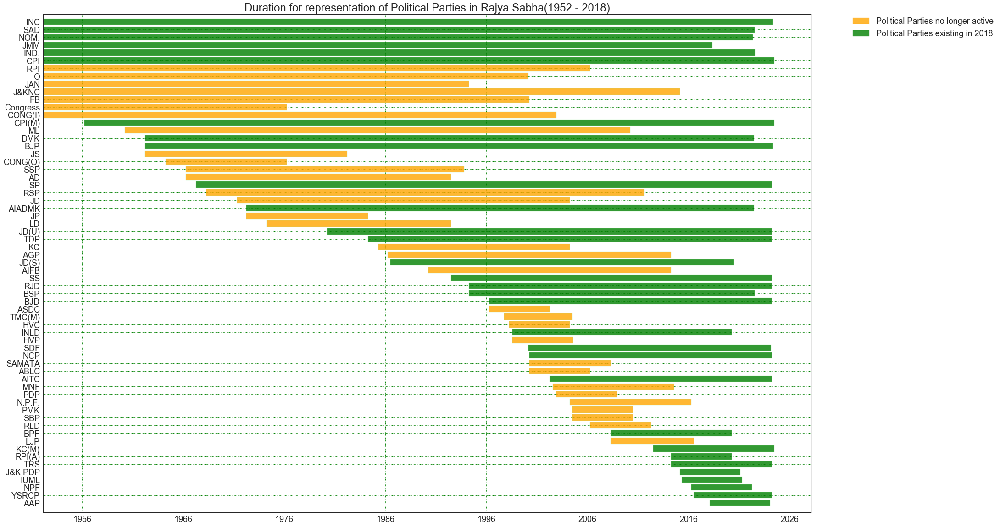

In [50]:
#plot Gantt chart
fig = plt.figure(figsize=(30,20))
ax = fig.add_subplot(111)
ylabels=PP_gantt_df.PARTY
ilen=len(ylabels)
pos = np.arange(0.5,ilen*0.5+0.5,0.5)
for i in range(len(ylabels)):
    start_date,end_date = PP_gantt_df[['TERM_From','TERM_To']].iloc[i]
    ax.barh((i*0.5)+0.5, PP_gantt_df.TERM_Diff.iloc[i], left=start_date, height=0.4, align='center', edgecolor='lightgreen', 
            color=PP_gantt_df.Color_encode.iloc[i], alpha = 0.8)
locsy, labelsy = plt.yticks(pos,ylabels)
plt.setp(labelsy, fontsize = 18)
plt.xticks(fontsize=18)
ax.axis('tight')
ax.set_ylim(ymin = -0.1, ymax = ilen*0.5+0.5)
ax.grid(color = 'g', linestyle = ':')
ax.xaxis_date()
or_patch = mpatches.Patch(color='orange',alpha = 0.8, label='Political Parties no longer active')
gr_patch = mpatches.Patch(color='green',alpha = 0.8, label='Political Parties existing in 2018')
plt.legend(handles=[or_patch,gr_patch],bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.,fontsize=18)
plt.title('Duration for representation of Political Parties in Rajya Sabha(1952 - 2018)',fontsize=24)

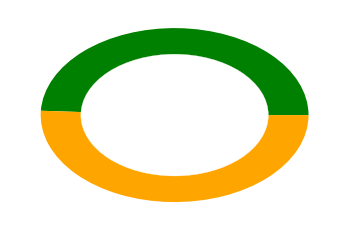

In [51]:
#plot donut chart showing proportion of categories
plt.pie(PP_gantt_df.groupby('Color_encode').size(),colors=list(PP_gantt_df.groupby('Color_encode').size().index),
        counterclock=True)
my_circle=plt.Circle( (0,0), 0.7, color='white')
p=plt.gcf()
p.gca().add_artist(my_circle)
plt.show()

#### Insights: 
India has a wide variety of political parties - regional, state wide and national. It is interesting to see that only half of the political parties are being represented in the current Rajya Sabha. More analysis needs to be performed on what happened to the 31 parties that are no longer represented - did they merge with others to form new parties or did they cease to exist?

### Visualizing Distribution of Tenure (1952-2018):
#### Description: 
This visualization plots the distribution of tenure of all members of Rajya Sabha highlighting the values for six terms.
#### Why this visualization type:
The intent of this visualization was to plot the distribution of member tenure. The most obvious choice to use is the histogram. This plot is a histogram plotted horizontally with bin size equal to 36. The horizontal orientation was more visually effective in combination to the tags than vertical orientation. 


In [42]:
#histogram of member terms
from datetime import datetime, timedelta
from dateutil import relativedelta
term_len=[]
for i in range(members_allyears.shape[0]):
    term_from = datetime.strptime(members_allyears.TERM_From.iloc[i], '%d/%m/%Y')
    term_to = datetime.strptime(members_allyears.TERM_To.iloc[i], '%d/%m/%Y') + timedelta(days=1)
    r = relativedelta.relativedelta(term_to, term_from)
    term_len.append(np.round((r.years*365+r.months*30+r.days)/365,1))
members_allyears['Term_length_mo']=term_len

In [43]:
#add up term lengths for each member
term_lens=members_allyears.groupby('NAME OF MEMBER').sum()

Text(0.5,1,'Distribution of tenure for members of Rajya Sabha(1952-2018)')

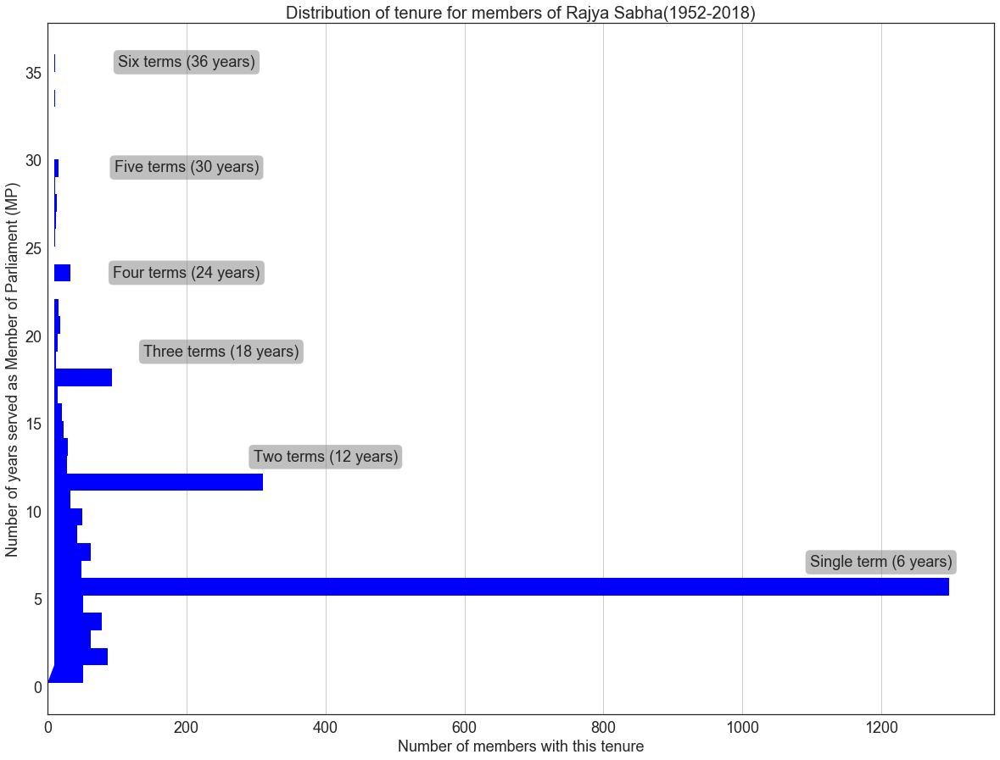

In [44]:
#plot histogram for term lengths
fig = plt.figure(figsize=(20,15))
ax1 = fig.add_subplot(1, 1, 1)
plt.hist(x=term_lens.Term_length_mo,bins=max(term_lens.Term_length_mo.astype('int')),bottom=10,
         histtype='stepfilled',orientation='horizontal',color='blue')
ax1.set_ylabel('Number of years served as Member of Parliament (MP)',fontsize=18)
ax1.set_xlabel('Number of members with this tenure',fontsize=18)
ax1.text(1200,7.5, 'Single term (6 years)',verticalalignment='top', horizontalalignment='center',fontsize=18,
            bbox=dict(facecolor='grey', alpha=0.5, boxstyle='round'))
ax1.text(400,13.5, 'Two terms (12 years)',verticalalignment='top', horizontalalignment='center',fontsize=18,
            bbox=dict(facecolor='grey', alpha=0.5, boxstyle='round'))
ax1.text(250,19.5, 'Three terms (18 years)',verticalalignment='top', horizontalalignment='center',fontsize=18,
            bbox=dict(facecolor='grey', alpha=0.5, boxstyle='round'))
ax1.text(200,24, 'Four terms (24 years)',verticalalignment='top', horizontalalignment='center',fontsize=18,
            bbox=dict(facecolor='grey', alpha=0.5, boxstyle='round'))
ax1.text(200,30, 'Five terms (30 years)',verticalalignment='top', horizontalalignment='center',fontsize=18,
            bbox=dict(facecolor='grey', alpha=0.5, boxstyle='round'))
ax1.text(200,36, 'Six terms (36 years)',verticalalignment='top', horizontalalignment='center',fontsize=18,
            bbox=dict(facecolor='grey', alpha=0.5, boxstyle='round'))
ax1.grid(axis='x')
plt.xticks(fontsize=18)
plt.yticks(fontsize=18)
plt.title('Distribution of tenure for members of Rajya Sabha(1952-2018)',fontsize=20)

#### Insights: 
The Indian Constitution has limited the number of years a member can serve on Rajya Sabha in one term to 6 years. There is no restriction on the number of times a member can be reelected to the House. This plot gives good insights on distribution and magnitude of tenures for all its 3000+ members since inception. Majority of the members have served just 1 term and did not get reelected. It is interesting to see a handful of members having served more than five terms which equate to 30+ years as Member of Parliament. It may be worth finding more details about their contributions and success stories. 


### Visualizing flow of questions between State and Ministries (2010-2018):
#### Description: 
This visualization shows the flow of all the 89,000 questions from State to Ministry that were asked in this decade. It is complemented by a bar chart that plots the proportion of members representing each state and offers a good visual comparison to the proportion of question volume generated by that state
#### Why this visualization type:
Sankey chart was chosen for this visualization because it perfectly encodes the magnitude and direction of flow from source to target. In addition to this, it is visually pleasing and does not overwhelm the audience with the scale of underlying data. This visualization plots the flow of 89K questions from 32 states to over 50 ministries. For such a scale, the chart type does a very good job. To complement the insights provided by Sankey chart, a simple bar chart showing the number of representatives allocated per state is provided for visual correlation between the number of representatives and the question volume.

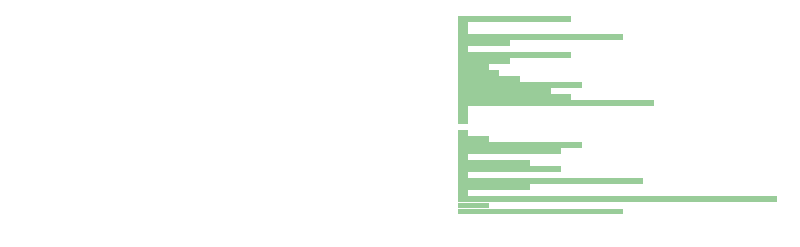

In [47]:
#plot Barchart showing number of representatives per state
rep=StateCensus[StateCensus['Rajyasabha representation']>0][['State','Rajyasabha representation']]
rep.columns=['State','rep']
#update representation for Andhra Pradesh
rep=rep.set_value(col='rep',value=11,index=rep[rep.State=='Andhra Pradesh'].index)
#update Delhi NCR -> National Capital Territory of Delhi
rep=rep.set_value(col='State',value='National Capital Territory of Delhi',index=rep[rep.State=='Delhi NCR'].index)
#add states values - NA, Nominated, Telengana
rep=rep.append({'State':'NA','rep':0},ignore_index=True)
rep=rep.append({'State':'Nominated','rep':12},ignore_index=True)
rep=rep.append({'State':'Telangana','rep':7},ignore_index=True)
rep.sort_values(by=['State'],ascending=False,inplace=True)

plt.barh(y=range(rep.shape[0]), width=rep.rep, align='center',height=0.9,color='green',alpha=0.4)
plt.yticks(range(rep.shape[0]), list(rep.State),fontsize=30)
#plt.gcf().set_size_inches(70,70)
plt.axis('off')
plt.show()

In [60]:
#create a copy of member name df to use as member lookup
lkp_member_name=members_allyears.copy()

In [61]:
#Standardize the name format in member lookup to match with the name format in question and answers.
name_formatted=[]
for i in range(lkp_member_name.shape[0]):
    name,title=lkp_member_name[['NAME OF MEMBER','Title_derivedcol']].iloc[i]
    name_split=name.replace(title,str("," + title)).split(',')
    #print(name_split,title)
    name_formatted.append(str.strip(name_split[1] + ' ' + name_split[0]))

#Add formatted name as a column to the dataframe
lkp_member_name['Name_Formatted']=name_formatted
lkp_member_name['Name_idx']=[str.lower(name) for name in name_formatted]
#Set formated name as the dataframe index for easy access to member attributes
lkp_member_name.set_index('Name_idx',inplace=True)

In [56]:
#Load session details
session_df=pd.read_csv('C:/Users/hsalil89/Documents/DS/Data Visualization/project/Data/rajyasabha_session.csv',engine='python')
session_df['start_date_formatted']=pd.to_datetime(session_df.session_start_date,dayfirst=False)
session_df['end_date_formatted']=pd.to_datetime(session_df.session_end_date,dayfirst=False)
session_df.pop('session_start_date')
session_df.pop('session_end_date')
session_df.set_index('session_no',inplace=True)

In [55]:
#function to lookup session number
def get_session(df_year,df_session):
    
    
    min_ans_date=np.min(df_year.answer_date_formatted)
    max_ans_date=np.max(df_year.answer_date_formatted)
    min_session_num=df_session.query(str('start_date_formatted<=\'' + str(min_ans_date) + '\'')).index.max()
    max_session_num=df_session.query(str('end_date_formatted>=\'' + str(max_ans_date) + '\'')).index.min()
    #initialize session_num as an array of min session nums of length df_year - because year 2014 has answer dates outside of the session dates range
    session_num=[min_session_num]*df_year.shape[0]
    print(min_ans_date,max_ans_date,min_session_num,max_session_num)
    for i in range(df_year.shape[0]):
        for j in range(min_session_num,max_session_num+1):
            if session_df.start_date_formatted.loc[j]<=df_year.answer_date_formatted.iloc[i]<=session_df.end_date_formatted.loc[j]:
                session_num[i]=j
                break
    return session_num

In [57]:
%%time
#Load all yearwise question and answer files
start_year=2009
years=range(start_year+1,2018)
df_complete=pd.read_csv(str('C:/Users/hsalil89/Documents/DS/Data Visualization/project/Data/rajyasabha_questions_and_answers_' + str(start_year) + '.csv'),engine='python')
df_complete.columns=['question', 'answer_date', 'ministry', 'question_type', 'question_no',
       'question_by', 'question_title', 'question_description', 'answer']
df_complete['answer_date_formatted']=pd.to_datetime(df_complete.answer_date,dayfirst=True)
df_complete.drop(columns=['question','question_type','question_no','question_description','answer','answer_date'],inplace=True)
df_complete['session_num']=get_session(df_complete,session_df)
df_complete['Year']=[start_year]*df_complete.shape[0]
for year in years:
    
    filename=str('C:/Users/hsalil89/Documents/DS/Data Visualization/project/Data/rajyasabha_questions_and_answers_' + str(year) + '.csv')
    df_year=pd.read_csv(filename,engine='python')
    #standardizing column names as files for some years have have different column names
    df_year.columns=['question', 'answer_date', 'ministry', 'question_type', 'question_no',
       'question_by', 'question_title', 'question_description', 'answer']
    df_year['answer_date_formatted']=pd.to_datetime(df_year.answer_date,dayfirst=True)
    df_year.drop(columns=['question','question_type','question_no','question_description','answer','answer_date'],inplace=True)
    df_year['session_num']=get_session(df_year,session_df)
    df_year['Year']=[year]*df_year.shape[0]
    df_complete=pd.concat([df_complete,df_year],ignore_index=True)
    #print(year,df_year.shape[0],df_complete.shape[0])

2009-11-20 00:00:00 2009-12-21 00:00:00 218 218
2010-02-23 00:00:00 2010-12-13 00:00:00 219 221
2011-02-22 00:00:00 2011-12-21 00:00:00 222 224
2012-03-13 00:00:00 2012-12-20 00:00:00 225 227
2013-02-22 00:00:00 2013-12-18 00:00:00 228 230
2014-02-05 00:00:00 2014-12-23 00:00:00 230 233
2015-02-24 00:00:00 2015-12-23 00:00:00 234 237
2016-02-24 00:00:00 2016-12-16 00:00:00 238 241
2017-02-02 00:00:00 2017-08-11 00:00:00 242 243
Wall time: 45.6 s


In [63]:
#Consolidate all member information in df_member_profile
df_member_profile=pd.DataFrame(df_complete.question_by.unique(),columns=['member_name'])

#remove Names = NaN
NaN_idx=df_member_profile[df_member_profile.member_name.isnull()].index
df_member_profile.drop(NaN_idx,axis=0,inplace=True)

#count of questions per session
countby_session=df_complete.groupby(['question_by','session_num']).size()
countby_session_df=countby_session.reset_index().set_index('question_by')

member_state=[]
member_party=[]
member_term_start=[]
member_term_end=[]
member_session=[]
member_qcount=[]
lkp_idx=lkp_member_name.index
for i in range(df_member_profile.shape[0]):
    name=df_member_profile.member_name.iloc[i]
    if str.lower(name) in lkp_idx:
        member_state.append(np.unique(lkp_member_name.STATE.at[str.lower(name)]))
        member_party.append(np.unique(lkp_member_name.PARTY.at[str.lower(name)]))
        member_term_start.append(lkp_member_name.TERM_From.at[str.lower(name)]) 
        member_term_end.append(lkp_member_name.TERM_To.at[str.lower(name)]) 
        member_session.append(countby_session_df.session_num.at[name])
        member_qcount.append(countby_session_df[0].at[name])

    else:
        member_state.append('NA')
        member_party.append('NA')
        member_term_start.append('NA')
        member_term_end.append('NA')
        member_session.append('NA')
        member_qcount.append('NA')
        
df_member_profile['State']=member_state
df_member_profile['Party']=member_party
df_member_profile['Term_start']=member_term_start
df_member_profile['Term_end']=member_term_end
df_member_profile['Session']=member_session
df_member_profile['Qcounts']=member_qcount

df_member_profile.set_index('member_name',inplace=True)
#Add the member name column back into data frame for further use
df_member_profile['member_name']=list(df_member_profile.index)

In [64]:
#Lookup and add member state
member_state=[]
lkp_idx=df_member_profile.index
for i in range(df_complete.shape[0]):
    name=df_complete.question_by.iloc[i]
    #member_names=df_member_profile['Name_Formatted'].unique()
    #print(name)
    #Some member names are not present in the lkp
    if name in lkp_idx:
        #members can be elected from multiple states during different terms so lookup can either return a single state or 
        #an array of states for members with multiple terms.
        #Taking only one state value for sankey chart if multiple found
        state_name=df_member_profile.State.at[name]
        
        if isinstance(state_name,np.ndarray):
            member_state.append(state_name[0])
        else:
            member_state.append(state_name)
    else:
        member_state.append('NA')
df_complete['Member_State']=member_state

In [66]:
#pip install pySankey
#https://github.com/anazalea/pySankey
from pySankey import sankey

Text(0.5,1,'Flow of questions from State to Ministries')

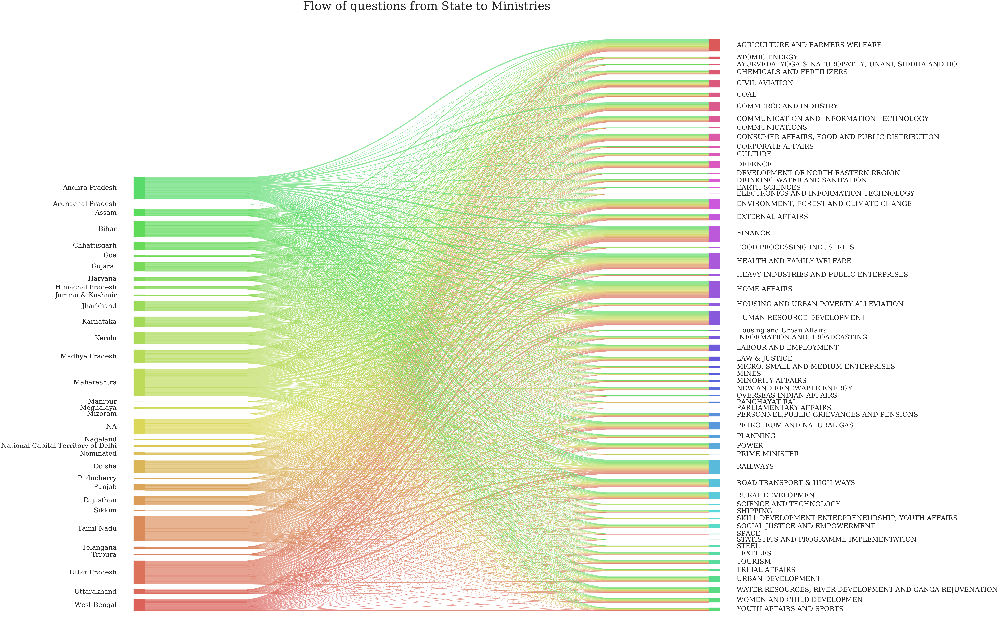

In [67]:
#plot sankey chart for all questions
sankey_all=df_complete[['Member_State','ministry','Year']]
#drop NaN records as Sankey cannot handle Nulls
NaN_idx=sankey_all[sankey_all.Member_State.isnull()].index
sankey_all.drop(NaN_idx,axis=0,inplace=True)
NaN_idx=sankey_all[sankey_all.ministry.isnull()].index
sankey_all.drop(NaN_idx,axis=0,inplace=True)
#Remove dups
ministry_dups=['AGRICULTURE','CONSUMER AFFAIRS AND PUBLIC DISTRIBUTION','ENVIRONMENT AND FORESTS','SKILL DEVELOPMENT AND ENTREPRENEURSHIP','WATER RESOURCES']
ministry_replace=['AGRICULTURE AND FARMERS WELFARE','CONSUMER AFFAIRS, FOOD AND PUBLIC DISTRIBUTION','ENVIRONMENT, FOREST AND CLIMATE CHANGE','SKILL DEVELOPMENT ENTERPRENEURSHIP, YOUTH AFFAIRS','WATER RESOURCES, RIVER DEVELOPMENT AND GANGA REJUVENATION']

ministry_fix=sankey_all.ministry.apply(lambda x:str.strip(x))
ministry_fix=ministry_fix.apply(lambda x:' '.join(x.split('  ')))
sankey_all.ministry=ministry_fix

for i in range(len(ministry_dups)):
    sankey_all.loc[sankey_all.ministry==ministry_dups[i],'ministry']=ministry_replace[i]
    
sankey_all.sort_values(by=['Member_State','ministry'],ascending=False,inplace=True)
sankey.sankey(sankey_all['Member_State'], sankey_all['ministry'], fontsize=40)
plt.gcf().set_size_inches(70,70)
plt.title('Flow of questions from State to Ministries',fontsize=70)

#### Insights: 
1. The visualization confirms the logical hypothesis that the volume of questions is roughly proportional to the number of members representing a state. Some exceptions include the state of Uttar Pradesh which has 31 members but has approximately same question volume as the next 2 states with highest representation namely – Maharashtra (19) and Tamil Nadu (18).
2. The data has members whose states are unavailable and are represented under the state name ‘NA’. 
3. The top five ministries that received questions are the Ministries of Finance, Railways, Home Affairs, Human Resource Development and Health and Family Welfare. The Ministries of Defense, Space, Atomic Energy have received less than expected questions. 

#### Enhancements:
1. The top five ministries that were the focus of majority of questions in this decade show that the country’s focus is still on building essential infrastructure and may indicate the ‘Developing’ phase of India’s journey. How would this change when India becomes a ‘Developed’ country? Further analysis is needed to find if there is a correlation between the top 5 ministries and the development index of the country.
2. Geographically, India can be divided into 6 regions – North, East ,West, South, Central and North East. Plotting the above graph by encoding these geographical regions with color can lead to further insights on regional priorities.


### Interactively visualizing volume of questions by Ministry or State (2010-2018):
#### Description: 
The above visualization gives a summarized view of how the questions were distributed by State and Ministry. To dig deeper, this interactive visualization allows users to select one Ministry or State and view how the volume of questions changes by year
#### Why this visualization type:
Jupyter Notebook provides useful widgets to add interactivity to plots. This visualization was created to enable further analysis on the question volume between states and ministries by allowing users to select specific states and ministries. Additional ability to filter by year was provided as a slider bar. 

In [68]:
# import libraries for interactive plots
#https://ipywidgets.readthedocs.io/en/latest/examples/Using%20Interact.html#interactive
from ipywidgets import interact, interactive, fixed, interact_manual, FloatSlider
import ipywidgets as widgets

In [70]:
#Interactive sankey plot - user can select state or ministry to zoom in details
#plt.gcf().set_size_inches(35,35)
states_sk=list(np.sort(sankey_all.Member_State.unique()))
ministry_sk=list(np.sort(sankey_all.ministry.unique()))
x_widget = widgets.Dropdown(options=['All','By State','By Ministry'], value='All', description='Select Key:', disabled=False,)
y_widget = widgets.Dropdown(options=['NA'], value='NA', description='Key Values:', disabled=False,)

play = widgets.Play(
#     interval=10,
    value=2009,
    min=2009,
    max=2017,
    step=1,
    description="Press play",
    disabled=False
)

slider = widgets.IntSlider(value=2009,min=2009,max=2017,step=1,description='Year:')


def update_keys(*args):
    if x_widget.value=='All':
        y_widget.options = 'NA'        
    elif x_widget.value=='By Ministry':
        y_widget.options = ministry_sk
    else:
        y_widget.options = states_sk
x_widget.observe(update_keys, 'value')

def plot_sankey(*args):
    q_year=slider.value
    print(slider.value)
#query_str='Member_State==\'Maharashtra\''
    if x_widget.value=='All':
        query_str=str('Year==' + str(slider.value))
        plt_title=str('Volume of questions from all states to all Ministries for Year ' + str(slider.value))
    elif x_widget.value=='By Ministry':
        query_str=str('ministry==\''+y_widget.value+'\' & Year==' + str(slider.value))
        plt_title=str('Volume of questions from all states to MINISTRY OF '+ y_widget.value + ' for Year ' + str(slider.value))
    else:
        query_str=str('Member_State==\''+y_widget.value+'\' & Year==' + str(slider.value))
        plt_title=str('Volume of questions from '+ y_widget.value + ' to all Ministries for Year ' + str(slider.value))
    select_state=sankey_all.query(query_str)[['Member_State','ministry']]
    select_state.sort_values(by=['Member_State','ministry'],ascending=False,inplace=True)
    #state_ordered=pd.Series(np.sort(select_state['Member_State'].unique()))
    #ministry_ordered=pd.Series(np.sort(select_state['ministry'].unique()))
    sankey.sankey(left=select_state['Member_State'], right=select_state['ministry'], fontsize=25)
                  
    plt.gcf().set_size_inches(35,35)
    plt.title(str(plt_title),fontsize=50)
    
slider.observe(plot_sankey,'value')

def plot_fig(x,y,z):
    plot_sankey()
#widgets.jslink((play, 'value'), (slider, 'value'))
#widgets.HBox([x_widget,y_widget,play, slider])
interact(plot_fig,x=x_widget, y=y_widget,z=slider);
#display(widgets.HBox([x_widget,y_widget,play, slider]))


interactive(children=(Dropdown(description='Select Key:', options=('All', 'By State', 'By Ministry'), value='A…

### Visualizing top 10 question topics by year (2010-2018):
#### Description: 
This custom built stacked word chart plots the word frequency of top 10 question topics for three Ministries from 2010 to 2017. The word size is proportional to the word frequency with the top-ranking words at the bottom and low-ranking words at the top. Python NLTK library is used to perform Natural Language Processing on the questions to extract tag words for question topics
#### Why this visualization type:
Word cloud was the method of choice for this visualization. However, the outcome was cluttered and did not allow comparing the trend of topics over multiple dimensions. This stacked word chart was custom built using the concepts of bar chart and scatter plot by managing horizontal and vertical offsets between words.

In [71]:
#Import NLP libraries from NLTK
import re
import nltk
from nltk.corpus import stopwords
from nltk.corpus import wordnet as wn
from nltk.corpus import sentiwordnet as swn 
from nltk.tag import pos_tag
from nltk.stem import WordNetLemmatizer
from wordcloud import WordCloud

In [72]:
#define stop words
stop = stopwords.words('english')
lemmatizer = WordNetLemmatizer()

In [73]:
#Define Regex pattern to identify topics
pattern_topical_nouns = r"""
  NP: {<NN.*|VB.*|CC|JJ.*|RP>*<IN|TO>}   # chunk determiner/possessive, adjectives and noun
      {<NN.*|VB.*|CC|JJ.*|RP>*<IN|TO>*<NN.*|VB.*|CC|JJ.*|RP>*}
"""
cp = nltk.RegexpParser(pattern_topical_nouns)

In [74]:
#define function to preprocess data
def nlp_preprocess(df):
    q_token_arr=[]
    q_token_POS=[]
    q_token_NP=[]
    for q in df.question_title:
        q_token= nltk.tokenize.word_tokenize(q,preserve_line=False)
        #remove stop words
        #q_tokenized=[str(word) for word in q_token if str(word).lower() not in stop]
        q_token=[lemmatizer.lemmatize(q_token[i].lower()) for i in range(len(q_token))]
        q_pos=nltk.pos_tag(q_token) 
        q_token_arr.append(q_token)
        q_token_POS.append(q_pos)
        q_token_NP.append(cp.parse(q_pos))
    df['q_token']=q_token_arr
    df['q_pos']=q_token_POS
    df['q_pos_NP']=q_token_NP
    return df

In [75]:
#define function to extract topics
def extract_topics(df):
    w=[]
    tag_dict={}
    for i in range(df.shape[0]):
        tags=[]
        t = list(df.q_pos_NP[i].subtrees(filter=lambda x: x.label()=='NP'))
            #print(t[len(t)-2],t[len(t)-1])
        
        if len(t)==0:
            tags.append('NA')
        elif len(t)>1:
            for j in [2,1]:
                tags.append([word for word,pos in t[len(t)-j] if pos in['NNP','NNS','NN']])
        else:
            #print(t)
            tags.append([word for word,pos in t[len(t)-1] if pos in['NNP','NNS','NN']])
        tag_dict[df['index'][i]]=tags
        w.append(tags)
    flattened_list = [z for x in w for y in x for z in y]
    return flattened_list,tag_dict

In [76]:
#define function to generate word frequencies
def dict_bag_of_words(flattened_list):
    dict_bag_of_words={}
    for idx in flattened_list:
        if idx in dict_bag_of_words.keys():
            dict_bag_of_words[idx]+=1 
        else:
            dict_bag_of_words[idx]=1
    return dict_bag_of_words

In [77]:
#define functions to plot word frequencies as bar chart
def plot_word_freq(D,top_count,title_word):
    if top_count==None:
        top_count=25
        
    df=pd.DataFrame.from_dict(D,orient='index',columns=['Counts'])
    df.sort_values(by=['Counts'],ascending=False,inplace=True)
    df_top=df.head(top_count)
    df_top.sort_index(ascending=False,inplace=True)
    fig = plt.figure(figsize=(10,7))
    ax = fig.add_subplot(111)
    my_range=range(1,len(df_top.index)+1)
    plt.barh(my_range, width=df_top.Counts, height=0.4, color='blue',alpha=0.3)
    plt.plot(df_top.Counts, my_range, "o",color='blue')
    plt.yticks(my_range, df_top.index)
    plt.grid(color='black',axis='x',linestyle = ':')
    plt.title('Word Frequencies for top ' + str(top_count) + ' words for '+ str(title_word))
    plt.show()

In [78]:
#Create dataframe to consolidate word frequencies by ministry
ministry=df_complete.ministry.unique()
years=list(df_complete.Year.unique())
level_ministry=np.repeat(ministry,len(years),axis=0)
level_year=np.array(years*len(ministry))
df_ministry_wc=pd.DataFrame(level_ministry,columns=['Ministry'])
df_ministry_wc['Year']=level_year
NaN_idx=df_ministry_wc[df_ministry_wc.Ministry.isnull()].index
df_ministry_wc.drop(NaN_idx,axis=0,inplace=True)

In [80]:
%%time
#Compute word frequencies by ministry

#df_temp.set_index('question_by',inplace=True)

tags_wc=[]

for i in range(df_ministry_wc.shape[0]):
    tags_dict={}
    ministry=df_ministry_wc.Ministry.iloc[i]
    year=str(df_ministry_wc.Year.iloc[i])
    query=str('ministry==\''+ ministry +'\' & Year==' + year)
    q_df=df_complete.query(query).question_title.reset_index()
    q_df_processed=nlp_preprocess(q_df)
    flattened_list,tags_dict_inc=extract_topics(q_df_processed)
    
    if len(flattened_list)>0:
        tags_dict.update(tags_dict_inc)
        dict_word_cnt=dict_bag_of_words(flattened_list)
        #wc = WordCloud().generate_from_frequencies(dict_word_cnt)
        tags_wc.append(dict_word_cnt)
    else :
        #wc=WordCloud().generate_from_frequencies({'No Data':100})
        tags_wc.append({'No Data':0})
df_ministry_wc['word_cloud']=tags_wc

Wall time: 3min 31s


(-150.00137992831543,
 3150.0013799283151,
 -150.00708241353937,
 3150.0070824135391)

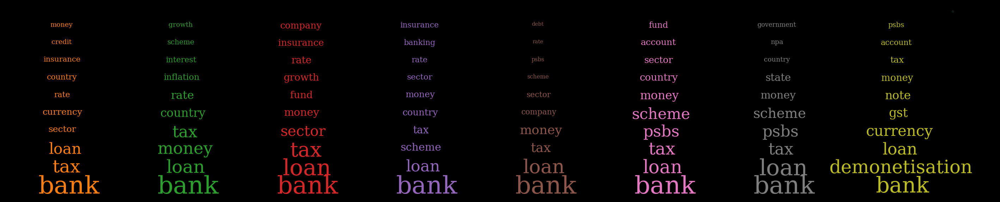

In [82]:
#plot word chart for top 10 question topics per ministry
style.use('dark_background')
fig = plt.figure(figsize=(50,10))
ax = fig.add_subplot(1, 1, 1)
plt.scatter([0,3000],[0,3000],alpha=0.1)
h_offset=0
j=0
cmap = plt.cm.get_cmap("tab20", 11)
for year in range(2010,2018):
    v_offset=100    
    query=str('Ministry==\''+ str('FINANCE') +'\' & Year==' + str(year))
    idx=df_ministry_wc.query(query).index[0]
    #print(year)
    #d=df_ministry_wc.word_cloud.at[idx]
    df=pd.DataFrame.from_dict(df_ministry_wc.word_cloud.at[idx],orient='index',columns=['Counts'])
    df.sort_values(by=['Counts'],ascending=False,inplace=True)
    df_top=df.head(10)
    df_top.sort_values(by=['Counts'],ascending=False,inplace=True)
    df_top.reset_index(inplace=True)
    df_top.columns=['Word','Counts']
    j+=1
    for i in range(df_top.shape[0]):
        t=np.random.randint(1)
        count=df_top.Counts.at[i]
        if count>70:
            count=70
        elif count<15:
            count=15
        ax.text(h_offset+count/2,v_offset+count, df_top.Word.at[i],verticalalignment='top', horizontalalignment='center',
                fontsize=count,color=cmap(j))
        v_offset+=300
    h_offset+=400
plt.axis('off')

#### Insights: 
The top three topics don’t change much over the years for any of the ministries. Overall, the topics visualized are reflective of reality and conform to our expectations as seen by the presence of the words ‘demonitization’ and ‘gst’ for Finance ministry in 2017 as both were hot topics in 2017.
#### Enhancements:
1. The NLP transformation done to extract topics from question titles can be enhanced to extract more meaningful tag words that are more reflective of the topic.
2. Sentiment Analysis can be coupled with this chart to plot the sentiment of the question using color encoding.


### Interactive Member Profile:
#### Description: 
This interactive visualization allows users to view demographic information and key performance metrics for any Member of Parliament. The details include Name, States represented, Political affiliations, Tenure and Term dates, Question count per session (2010 onwards) and top 25 topics for questions asked (2010 onwards). Members are categorized by most recent state represented so selecting the state filter first narrows down the Member list significantly.

In [93]:
#change the plotting style
style.use('seaborn-white')

In [91]:
%%time
#df_temp.set_index('question_by',inplace=True)
tags_dict={}
tags_wc=[]
for i in range(df_member_profile.shape[0]):
    name=df_member_profile.member_name.iloc[i]
    query=str('question_by==\''+ name +'\'')
    q_df=df_complete.query(query).question_title.reset_index()
    q_df_processed=nlp_preprocess(q_df)
    flattened_list,tags_dict_inc=extract_topics(q_df_processed)
    tags_dict.update(tags_dict_inc)
    dict_word_cnt=dict_bag_of_words(flattened_list)
    #wc = WordCloud().generate_from_frequencies(dict_word_cnt)
    tags_wc.append(dict_word_cnt)
df_member_profile['word_cloud']=tags_wc

Wall time: 3min 33s


In [94]:
#Interactive member profile
states=np.unique(lkp_member_name.STATE)
states[-1]='All States'
members=np.unique(lkp_member_name.Name_Formatted)
print('Narrow down the search result for member names by selecting the state first')
x_widget = widgets.Dropdown(options=states, value='All States', description='State:', disabled=False,)
y_widget = widgets.Dropdown(options=members, value=members[0], description='Member:', disabled=False,)

def update_names(*args):
    if x_widget.value!='All States':
        query_str=str('STATE==\''+x_widget.value+'\'')
        y_widget.options = np.unique(lkp_member_name.query(query_str).Name_Formatted)
    else:
        y_widget.options=members
        
x_widget.observe(update_names, 'value')

def printer(x, y):
    if y in df_member_profile.index:
        print('Member Profile')
        print('Name: ',y)
        print('State Represented: ',df_member_profile.State.at[y])
        print('Political Party: ',df_member_profile.Party.at[y])
        
        if isinstance(df_member_profile.Term_start.at[y],np.ndarray):
            for i in range(len(df_member_profile.Term_start.at[y])):
                print('Term ',i+1,': ',df_member_profile.Term_start.at[y][i],'-',df_member_profile.Term_end.at[y][i])
        else:
            print('Term 1: ',df_member_profile.Term_start.at[y],'-',df_member_profile.Term_end.at[y])
        #print('Trend of questions asked per session:')
        plt.bar(df_member_profile.Session.at[y], height=df_member_profile.Qcounts.at[y], width=0.3, align='center', edgecolor='lightgreen', 
            color='blue', alpha = 0.8)
        plt.xticks(df_member_profile.Session.at[y])
        plt.title('Trend of questions asked per session')
        #plt.yticks(np.arange(0, 350, 50))
        plt.show()
        #print('Word frequency of most common topics raised by this member: ')
        plot_word_freq(df_member_profile.word_cloud.at[y],25,y)
        
    else:
        print('Profile not found.')
        
interact_manual(printer,x=x_widget, y=y_widget);

Narrow down the search result for member names by selecting the state first


interactive(children=(Dropdown(description='State:', index=47, options=('Ajmer and Coorg', 'Andhra Pradesh', '…

#### Insights: 
1. Members can be elected from multiple states in different terms over their tenure in Rajya Sabha.
2. Members often change political party affiliations to get elected or can be nominated by the President.
3. One term in Rajya Sabha is for 6 years and members can serve more than 1 term. This member in the example is the highest tenured member of Rajya Sabha and is serving his 6th term which equates to 36 years as a Member of Parliament.

#### Enhancements:
Though this visualization provides good insights, it need enhancement to beautify presentation. Further details about the member like educational background, profile photo, Ministry handled etc. can also be added to enhance this visualization.

## Future Work:
The Rajya Sabha archives present tremendous opportunity for data visualization. This project has just scratched the surface and will need further refinement in improving the accuracy as well as scale of data.
Specifically, future work can be planned in the below areas -
### Improving accuracy of Topic Extraction algorithm - 
The algorithm used by this project is very basic and needs to be enhanced to capture the question topics accurately. Advanced NLP and NLU libraries can be used to identify entities and relations in the question titles.

### Sentiment Analysis and Topic Categorization - 
Broadly, the questions can be categorized into three categories - to get more information, to hold minister accountable and to bring ministry's notice to some topic. Being able to identify the sentiment and category of question can lead to new insights. 

### Scaling up to accomodate entire Q&A archives - 
This project only focuses on the question and answers data from 2009-2018. It can be scaled up to source all the available data from 1952 till current. 

### Interactive visualizations -
Adding more interactive capabilities like ability to get details by hovering over the visualization, filtering and aggregations will help create more engaging visualizations. 